In [4]:
!pip install cellpose
!pip install tifffile
!pip install scikit-image
!pip install matplotlib

     |████████████████████████████████| 12.7 MB 8.1 MB/s eta 0:00:01
     |████████████████████████████████| 1.6 MB 7.2 MB/s eta 0:00:01
     |████████████████████████████████| 7.2 MB 633 kB/s eta 0:00:01
     |████████████████████████████████| 4.3 MB 7.5 MB/s eta 0:00:01
  Using cached imageio-2.9.0-py3-none-any.whl (3.3 MB)
     |████████████████████████████████| 2.8 MB 670 kB/s eta 0:00:01
     |████████████████████████████████| 61 kB 6.9 MB/s eta 0:00:01
  Using cached cycler-0.10.0-py2.py3-none-any.whl (6.5 kB)
  Attempting uninstall: decorator
    Found existing installation: decorator 5.0.9
    Uninstalling decorator-5.0.9:
      Successfully uninstalled decorator-5.0.9


In [1]:
import numpy as np
import time, os, sys
import skimage.io
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 300

from cellpose import models
from cellpose import io as cellio

from glob import glob
from tifffile import imread, imwrite

2021-06-25 10:20:23,315 [INFO] WRITING LOG OUTPUT TO /Users/u1604749/.cellpose/run.log


## Preprocessing

In [2]:
# Input
filepaths = sorted(glob('../EF_Tonsil/Tonsil/*.tif'))
filenames = [os.path.basename(filepath) for filepath in filepaths]
files = [imread(file) for file in filepaths]

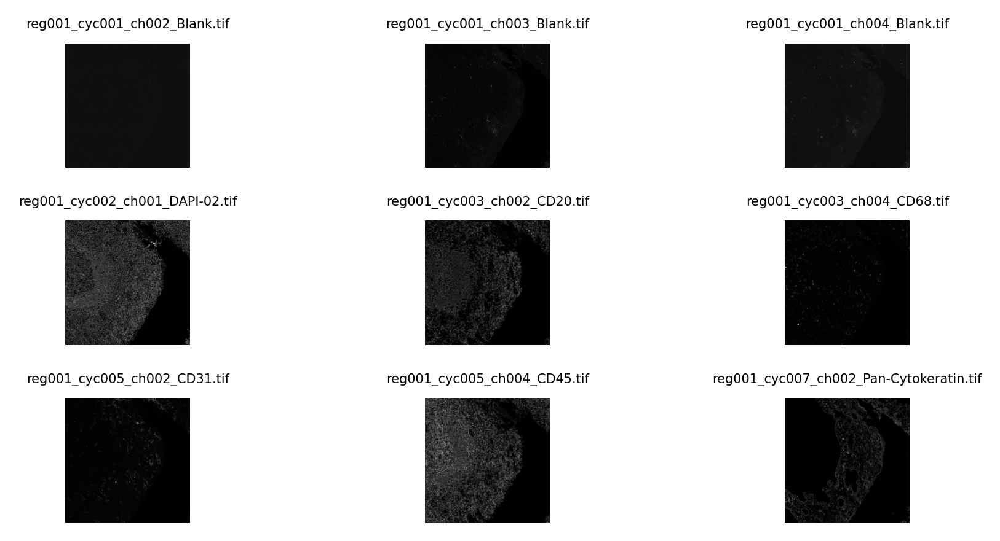

In [4]:
# Cropping and visualisation
r = 800 # row
c = 2516 # column
w = 512 * 4 # width
h = 512 * 4 # height

fig_columns = 3
save_cropped_images = True
save_img_dir = 'cropped/'

for i,file in enumerate(files):
    plt.subplot(len(files)//fig_columns+1, fig_columns, i+1)
    plt.imshow(file[r:r+h, c:c+w], cmap='gray')
    plt.axis('off')
    plt.title(filenames[i], {'fontsize': 5})
    
    if save_cropped_images:
        imwrite(save_img_dir + 'DCcropped_' + filenames[i], file[r:r+h, c:c+w])

plt.tight_layout()
plt.show()

## Segmentation

In [69]:
# Input
indir = 'cropped/'
files = sorted(glob(indir+'*.tif'))

In [70]:
# Initalisation
imgs = [skimage.io.imread(f) for f in files]
nimg = len(imgs)

print(nimg, 'image(s)')

9 image(s)


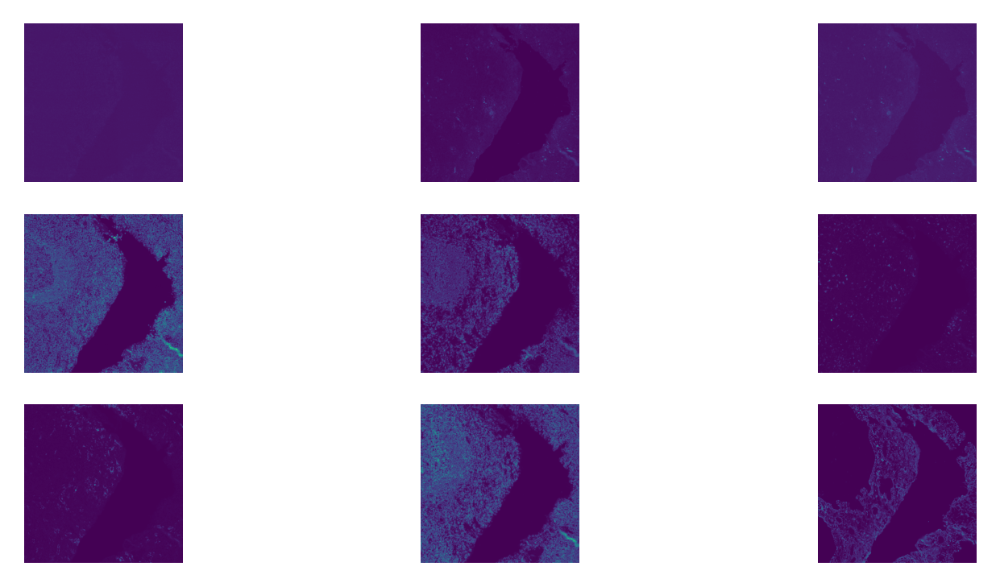

In [73]:
for k, img in enumerate(imgs):
    plt.subplot(nimg//3+1,3,k+1)
    plt.axis('off')
    plt.imshow(img)

plt.show()

In [74]:
model = models.Cellpose(model_type='cyto')

channels = [[0,0]]

masks, flows, styles, diams = model.eval(imgs, diameter=30, flow_threshold=None, channels=channels)

2021-06-03 12:33:27,104 [INFO] >>>> using CPU
2021-06-03 12:33:27,173 [INFO] ~~~ FINDING MASKS ~~~
2021-06-03 13:41:44,764 [INFO] 100%|##########| 9/9 [1:08:17<00:00, 455.29s/it]
2021-06-03 13:41:44,765 [INFO] >>>> TOTAL TIME 4097.59 sec


9


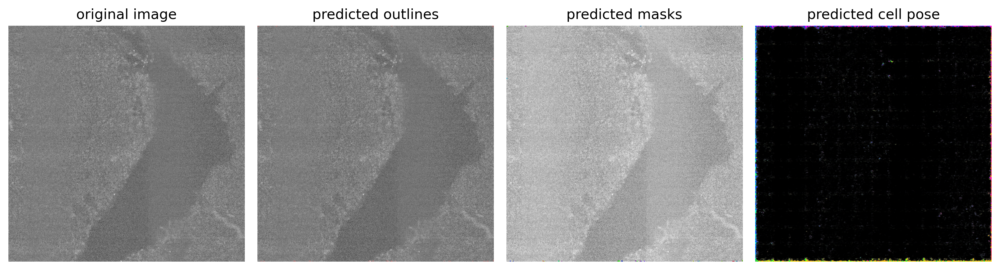

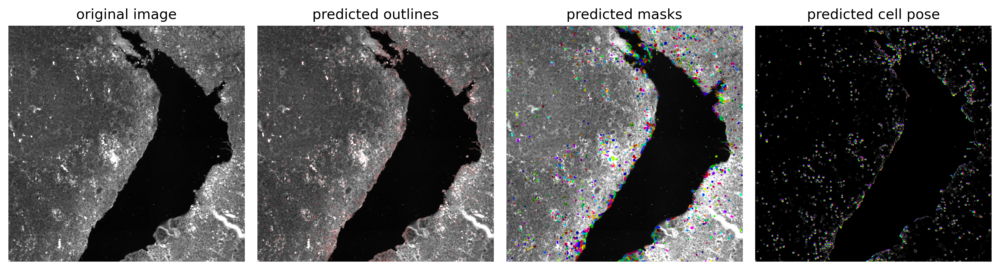

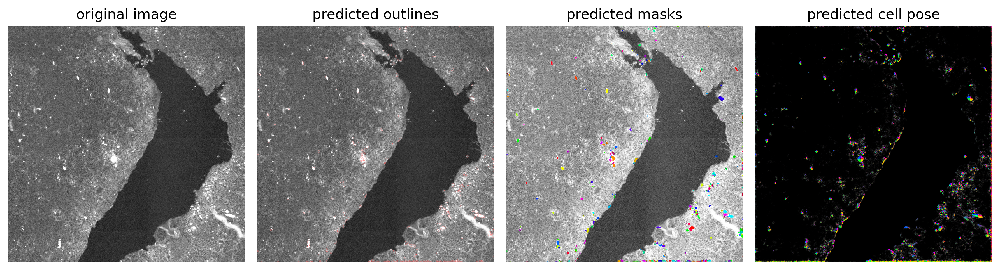

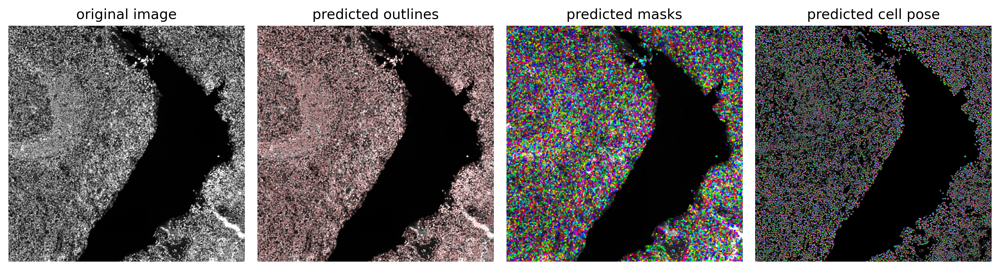

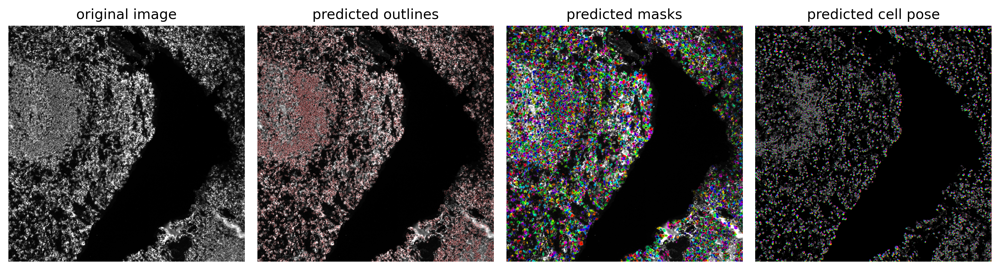

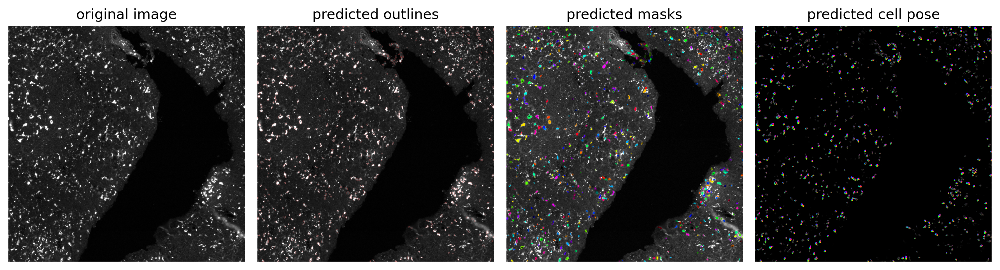

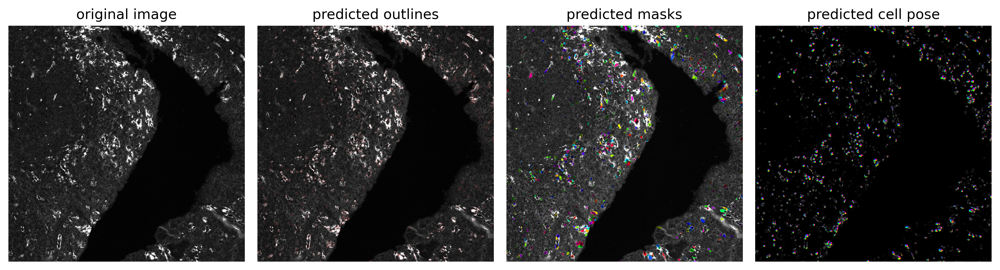

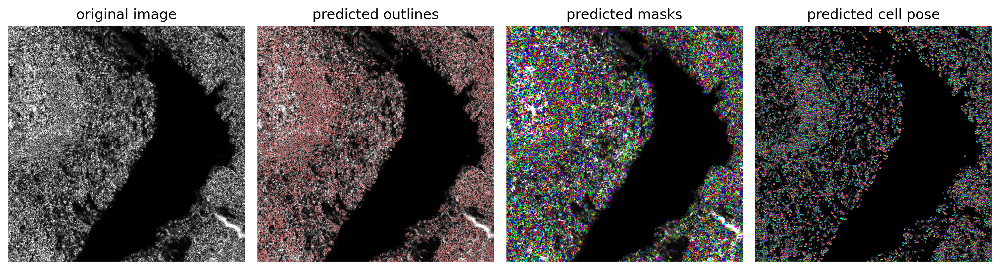

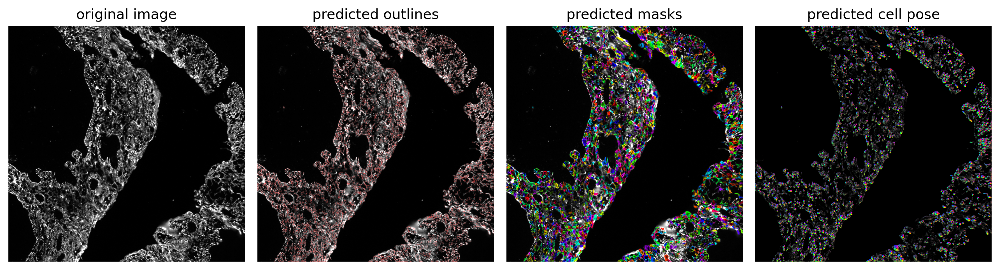

In [79]:
# DISPLAY RESULTS
from cellpose import plot

# fig = plt.figure(figsize=(12,5))
# plot.show_segmentation(fig, img, masks[0], flows[0][0], channels=channels)
# plt.tight_layout()
# plt.show()

nimg = len(imgs)
print(nimg)
for i,img in enumerate(imgs):
    maski = masks[i]
    flowi = flows[i][0]

    fig = plt.figure(figsize=(12,5))
    plot.show_segmentation(fig, img, maski, flowi, channels=channels[0])
    plt.tight_layout()
    plt.show()

In [80]:
from cellpose import io

io.masks_flows_to_seg(imgs, masks, flows, diams, files, channels)

In [82]:
[print(file) for file in files]

cropped/cropped_reg001_cyc001_ch002_Blank.tif
cropped/cropped_reg001_cyc001_ch003_Blank.tif
cropped/cropped_reg001_cyc001_ch004_Blank.tif
cropped/cropped_reg001_cyc002_ch001_DAPI-02.tif
cropped/cropped_reg001_cyc003_ch002_CD20.tif
cropped/cropped_reg001_cyc003_ch004_CD68.tif
cropped/cropped_reg001_cyc005_ch002_CD31.tif
cropped/cropped_reg001_cyc005_ch004_CD45.tif
cropped/cropped_reg001_cyc007_ch002_Pan-Cytokeratin.tif


[None, None, None, None, None, None, None, None, None]